In [92]:
import numpy as np
import pandas as pd
import statsmodels.api as sm
from sklearn.metrics import roc_auc_score, roc_curve, confusion_matrix, classification_report, precision_recall_curve, auc
from pathlib import Path
import pickle
from lime.lime_tabular import LimeTabularExplainer
import shap
import matplotlib.pyplot as plt
from sklearn.inspection import PartialDependenceDisplay

DATA_PATH = Path("data/processed")

In [93]:
# Reading the data and preparing dependent and independent variables 
df = pd.read_csv(DATA_PATH / 'train.csv')
X = df.drop(columns=['Unnamed: 0', 'into_default'])
y = df['into_default']

In [94]:
# Logistic
with open("models/logistic_model.pkl", "rb") as f:
    logit_model = pickle.load(f)

# XGBoost
with open("models/xgb_model.pkl", "rb") as f:
    xgb_model = pickle.load(f)


### Logistic Regression

In [95]:
result = logit_model.fit()

# Displaying summary of the model 
print(result.summary())

Optimization terminated successfully.
         Current function value: 0.228845
         Iterations 9
                           Logit Regression Results                           
Dep. Variable:           into_default   No. Observations:                33986
Model:                          Logit   Df Residuals:                    33977
Method:                           MLE   Df Model:                            8
Date:                Thu, 29 May 2025   Pseudo R-squ.:                 0.03872
Time:                        17:30:13   Log-Likelihood:                -7777.5
converged:                       True   LL-Null:                       -8090.8
Covariance Type:            nonrobust   LLR p-value:                4.531e-130
                                                  coef    std err          z      P>|z|      [0.025      0.975]
---------------------------------------------------------------------------------------------------------------
const                                     

In [96]:
X = df.drop(columns=['Unnamed: 0', 'into_default', 'Wskaźnik rotacji kapitału obrotowego (x)', 
                     'Obrót aktywów bieżących (x)', 'Wskaźnik rotacji aktywów (x)'])
X_const = sm.add_constant(X)

y_pred_prob = result.predict(X_const)

# AUC-ROC calculation 
auc_roc = roc_auc_score(y, y_pred_prob)

print(f'AUC-ROC: {auc_roc:.4f}')

AUC-ROC: 0.6946


### Threshold estimation 

In [97]:
# ROC calculation 
fpr, tpr, thresholds = roc_curve(y, y_pred_prob)

# Ommiting first threshold 
if thresholds[0] > 1:
    thresholds = thresholds[1:]
    fpr = fpr[1:]
    tpr = tpr[1:]

# (TPR - FPR) calculation 
youdenJ = tpr - fpr
best_index = youdenJ.argmax()
best_thresh = thresholds[best_index]

print("Optimal threshold (in terms of Youden statistic): {:.3f}".format(best_thresh))
print("True Positive Rate: {:.3f}".format(tpr[best_index]))
print("False Positive Rate: {:.3f}".format(fpr[best_index]))

Optimal threshold (in terms of Youden statistic): 0.064
True Positive Rate: 0.792
False Positive Rate: 0.486


### Confusion matrix

Confusion matrix (threshold = 0.064):
TN: 16340, FP: 15468, FN: 452, TP: 1726

Classification report:
              precision    recall  f1-score   support

           0      0.973     0.514     0.672     31808
           1      0.100     0.792     0.178      2178

    accuracy                          0.532     33986
   macro avg      0.537     0.653     0.425     33986
weighted avg      0.917     0.532     0.641     33986


Classification report:
              precision    recall  f1-score   support

           0      0.973     0.514     0.672     31808
           1      0.100     0.792     0.178      2178

    accuracy                          0.532     33986
   macro avg      0.537     0.653     0.425     33986
weighted avg      0.917     0.532     0.641     33986



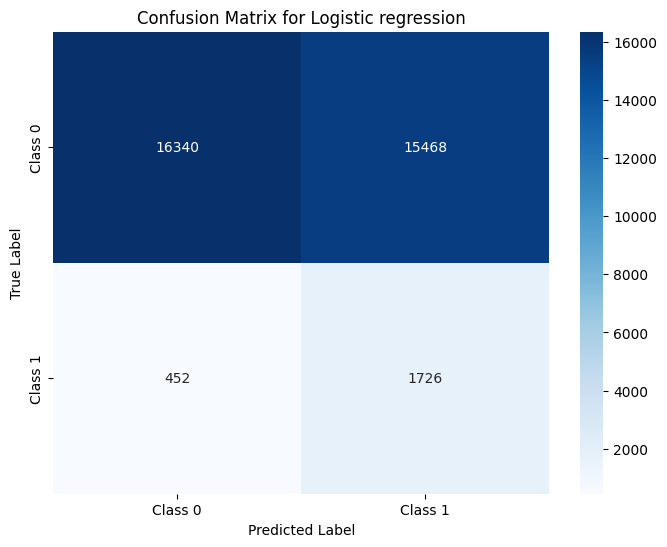

In [98]:
# Classification 
y_preds_opt = (y_pred_prob >= best_thresh).astype(int)

# Confusion matrix 
tn, fp, fn, tp = confusion_matrix(y, y_preds_opt).ravel()
print("Confusion matrix (threshold = {:.3f}):".format(best_thresh))
print(f"TN: {tn}, FP: {fp}, FN: {fn}, TP: {tp}")

# Report 
print("\nClassification report:")
print(classification_report(y, y_preds_opt, digits=3))

# Report 
print("\nClassification report:")
print(classification_report(y, y_preds_opt, digits=3))

def plot_confusion_matrix(y_true, y_pred, model_name):

    # Compute the confusion matrix
    cm = confusion_matrix(y_true, y_pred)

    # Plot confusion matrix
    plt.figure(figsize=(8, 6))
    sns.heatmap(cm, annot=True, fmt='d', cmap='Blues', xticklabels=['Class 0', 'Class 1'], yticklabels=['Class 0', 'Class 1'])
    plt.title(f"Confusion Matrix for {model_name}")
    plt.xlabel("Predicted Label")
    plt.ylabel("True Label")
    plt.show()

plot_confusion_matrix(y, y_preds_opt, 'Logistic regression')

### Testing the model 

In [99]:
# Reading the data and preparing dependent and independent variables 
df_test = pd.read_csv(DATA_PATH / 'test.csv')
X_test = df_test.drop(columns=['Unnamed: 0', 'into_default', 'Wskaźnik rotacji kapitału obrotowego (x)', 
                          'Obrót aktywów bieżących (x)', 'Wskaźnik rotacji aktywów (x)'])
y_test = df_test['into_default']
X_test_const = sm.add_constant(X_test)

In [100]:
# Predicting target 
y_test_pred_prob = result.predict(X_test_const)

# AUC-ROC calculation 
auc_roc = roc_auc_score(y_test, y_test_pred_prob)

print(f'AUC-ROC: {auc_roc:.4f}')

AUC-ROC: 0.6906


### Confusion matrix for testing sample

Confusion matrix (threshold = 0.064):
TN: 4004, FP: 3949, FN: 123, TP: 421

Classification report:
              precision    recall  f1-score   support

           0      0.970     0.503     0.663      7953
           1      0.096     0.774     0.171       544

    accuracy                          0.521      8497
   macro avg      0.533     0.639     0.417      8497
weighted avg      0.914     0.521     0.631      8497



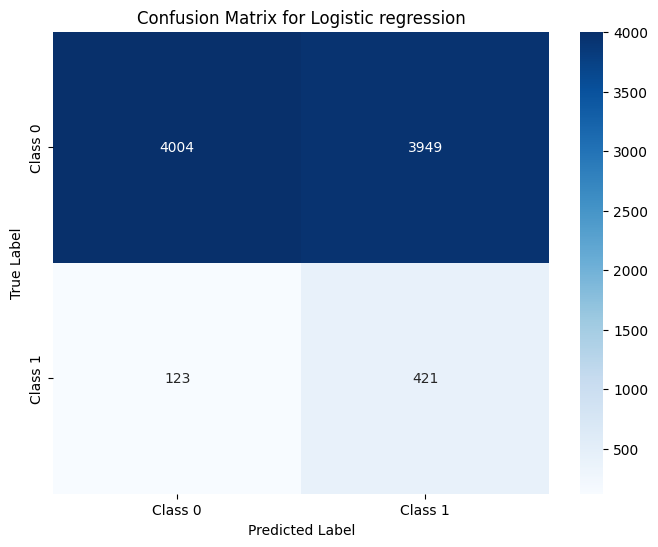

In [101]:
# Classification 
y_preds_opt = (y_test_pred_prob >= best_thresh).astype(int)

# Confusion matrix 
tn, fp, fn, tp = confusion_matrix(y_test, y_preds_opt).ravel()
print("Confusion matrix (threshold = {:.3f}):".format(best_thresh))
print(f"TN: {tn}, FP: {fp}, FN: {fn}, TP: {tp}")

# Report 
print("\nClassification report:")
print(classification_report(y_test, y_preds_opt, digits=3))

plot_confusion_matrix(y_test, y_preds_opt, 'Logistic regression')

### XGBoost

In [102]:
# Reading the data and preparing dependent and independent variables 
df = pd.read_csv(DATA_PATH / 'train.csv')
X = df.drop(columns=['Unnamed: 0', 'into_default'])
y = df['into_default']

In [103]:
# Translation
column_translation = {
    'Aktywa razem/Kapitał własnyj (%)': 'Total assets / Equity (%)',
    'Wskaźnik rotacji kapitału obrotowego (x)': 'Working capital turnover ratio (x)',
    'Kapitał obrotowy': 'Working capital',
    'Obrót aktywów bieżących (x)': 'Current assets turnover (x)',
    'Gotówka netto': 'Net cash',
    'Stopa zwrotu z kapitału własnego (ROE) (%)': 'Return on equity (ROE) (%)',
    'Kapitał własny ogółem': 'Total equity',
    'Wskaźnik rotacji aktywów (x)': 'Asset turnover ratio (x)',
    'Operacyjny wskaźnik rentowności aktywów (%)': 'Operating return on assets (%)',
    'Zwrot z kapitału zaangażowanego (%)': 'Return on invested capital (%)',
    'Wiek firmy (lata)': 'Company age (years)'
}

X.rename(columns=column_translation, inplace=True)

print(X.columns)

Index(['Total assets / Equity (%)', 'Working capital turnover ratio (x)',
       'Working capital', 'Current assets turnover (x)', 'Net cash',
       'Return on equity (ROE) (%)', 'Total equity',
       'Asset turnover ratio (x)', 'Operating return on assets (%)',
       'Return on invested capital (%)', 'Company age (years)'],
      dtype='object')


In [104]:
y_pred_proba_xgb = xgb_model.predict_proba(X)[:, 1]

### Threshold estimation

In [105]:
# ROC calculation 
fpr, tpr, thresholds = roc_curve(y, y_pred_proba_xgb)

# Ommiting first threshold 
if thresholds[0] > 1:
    thresholds = thresholds[1:]
    fpr = fpr[1:]
    tpr = tpr[1:]

# (TPR - FPR) calculation 
youdenJ = tpr - fpr
best_index = youdenJ.argmax()
best_thresh = thresholds[best_index]

print("Optimal threshold (in terms of Youden statistic): {:.3f}".format(best_thresh))
print("True Positive Rate: {:.3f}".format(tpr[best_index]))
print("False Positive Rate: {:.3f}".format(fpr[best_index]))

Optimal threshold (in terms of Youden statistic): 0.083
True Positive Rate: 0.789
False Positive Rate: 0.231


### Confusion matrix

Confusion matrix (threshold = 0.083):
TN: 24463, FP: 7345, FN: 460, TP: 1718

Classification report:
              precision    recall  f1-score   support

           0      0.982     0.769     0.862     31808
           1      0.190     0.789     0.306      2178

    accuracy                          0.770     33986
   macro avg      0.586     0.779     0.584     33986
weighted avg      0.931     0.770     0.827     33986



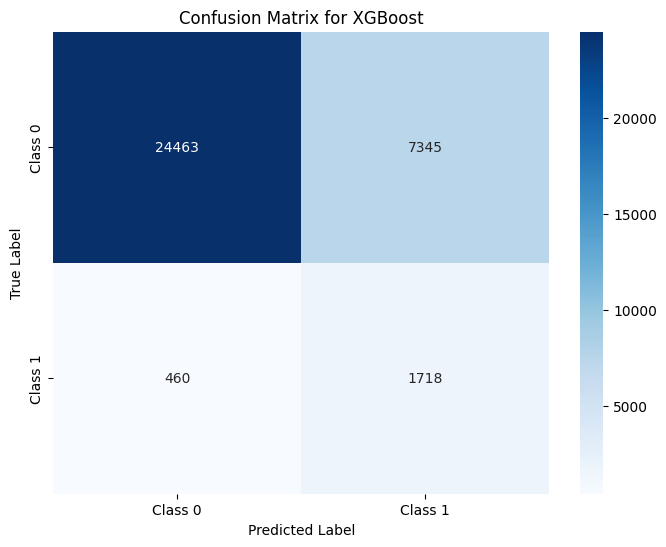

In [106]:
# Classification 
y_preds_opt = (y_pred_proba_xgb >= best_thresh).astype(int)

# Confusion matrix 
tn, fp, fn, tp = confusion_matrix(y, y_preds_opt).ravel()
print("Confusion matrix (threshold = {:.3f}):".format(best_thresh))
print(f"TN: {tn}, FP: {fp}, FN: {fn}, TP: {tp}")

# Report 
print("\nClassification report:")
print(classification_report(y, y_preds_opt, digits=3))

def plot_confusion_matrix(y_true, y_pred, model_name):

    # Compute the confusion matrix
    cm = confusion_matrix(y_true, y_pred)

    # Plot confusion matrix
    plt.figure(figsize=(8, 6))
    sns.heatmap(cm, annot=True, fmt='d', cmap='Blues', xticklabels=['Class 0', 'Class 1'], yticklabels=['Class 0', 'Class 1'])
    plt.title(f"Confusion Matrix for {model_name}")
    plt.xlabel("Predicted Label")
    plt.ylabel("True Label")
    plt.show()

plot_confusion_matrix(y, y_preds_opt, 'XGBoost')

### Testing the model

In [107]:
# Reading the data and preparing dependent and independent variables 
df_test = pd.read_csv(DATA_PATH / 'test.csv')
X_test = df_test.drop(columns=['Unnamed: 0', 'into_default'])
y_test = df_test['into_default']
X_test.rename(columns=column_translation, inplace=True)

AUC-ROC: 0.7879
Confusion matrix (threshold = 0.083):
TN: 6043, FP: 1910, FN: 170, TP: 374

Classification report:
              precision    recall  f1-score   support

           0      0.973     0.760     0.853      7953
           1      0.164     0.688     0.264       544

    accuracy                          0.755      8497
   macro avg      0.568     0.724     0.559      8497
weighted avg      0.921     0.755     0.815      8497



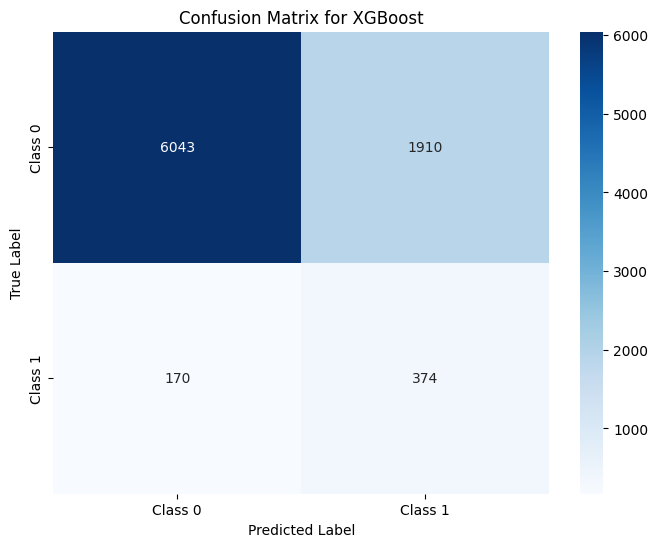

In [108]:
y_pred_proba_xgb = xgb_model.predict_proba(X_test)[:, 1]
threshold = best_thresh

auc_roc = roc_auc_score(y_test, y_pred_proba_xgb)
print(f'AUC-ROC: {auc_roc:.4f}')

# Classification 
y_preds_opt = (y_pred_proba_xgb >= threshold).astype(int)

# Confusion matrix 
tn, fp, fn, tp = confusion_matrix(y_test, y_preds_opt).ravel()
print("Confusion matrix (threshold = {:.3f}):".format(threshold))
print(f"TN: {tn}, FP: {fp}, FN: {fn}, TP: {tp}")

# Report 
print("\nClassification report:")
print(classification_report(y_test, y_preds_opt, digits=3))

plot_confusion_matrix(y_test, y_preds_opt, 'XGBoost')

### SHAP

### 1. SHAP values calculation

In [109]:
explainer = shap.TreeExplainer(xgb_model)

shap_values = explainer.shap_values(X)
print(f'Shape: {shap_values.shape}')
pd.DataFrame(shap_values).head(3)

Shape: (33986, 11)


,0,1,2,3,4,5,6,7,8,9,10
0,-0.729933,-0.012787,-0.005312,0.197199,-0.279867,-0.098344,0.246756,-0.046113,-0.021867,-0.039187,-0.090012
1,0.986318,-0.113112,-0.079321,-0.080385,0.225428,-0.069730,-0.023767,-0.089073,0.058783,0.019830,0.168748
2,0.714567,0.533204,0.266335,0.029566,0.152302,-0.134229,0.061785,0.016281,0.007827,-0.049162,0.000131


### 2. Simplified SHAP variable importance plot (SHAP values are in absolute log-odds)

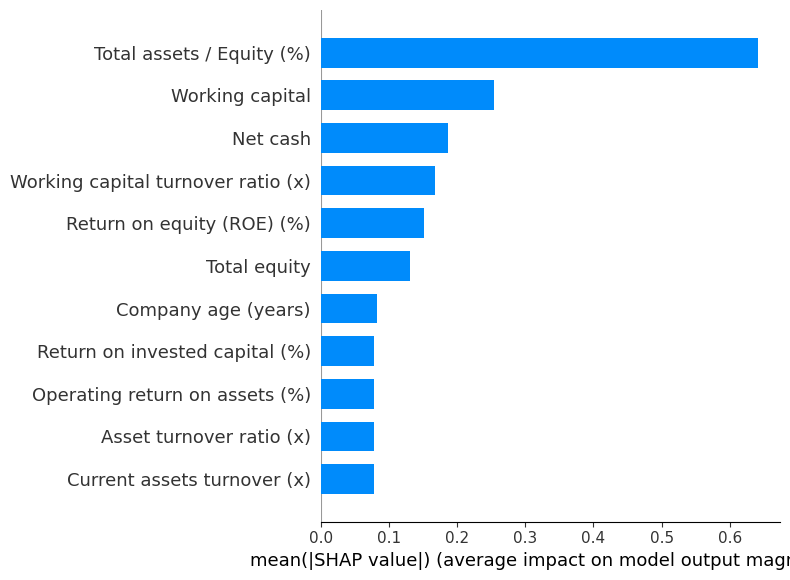

In [110]:
shap.summary_plot(shap_values, X, plot_type='bar')

### 3. SHAP variable importance plot 

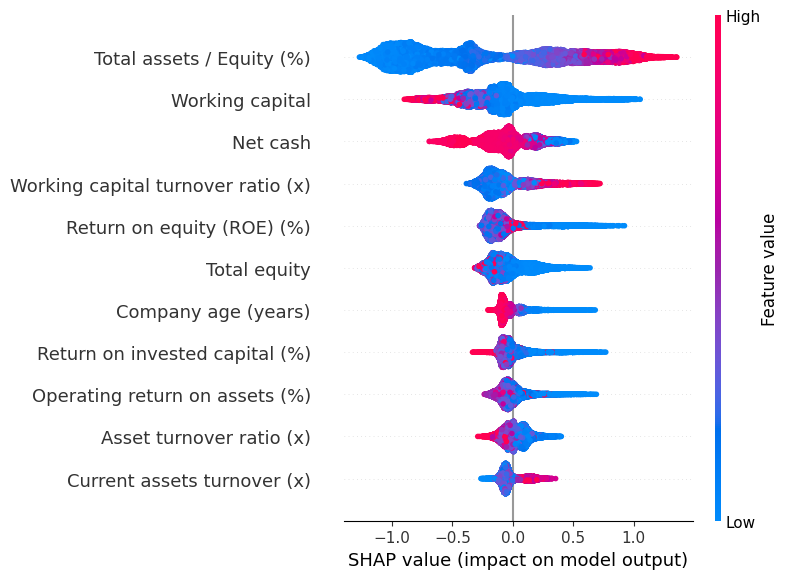

In [111]:
shap.summary_plot(shap_values, X)

### 4. Dependency plots

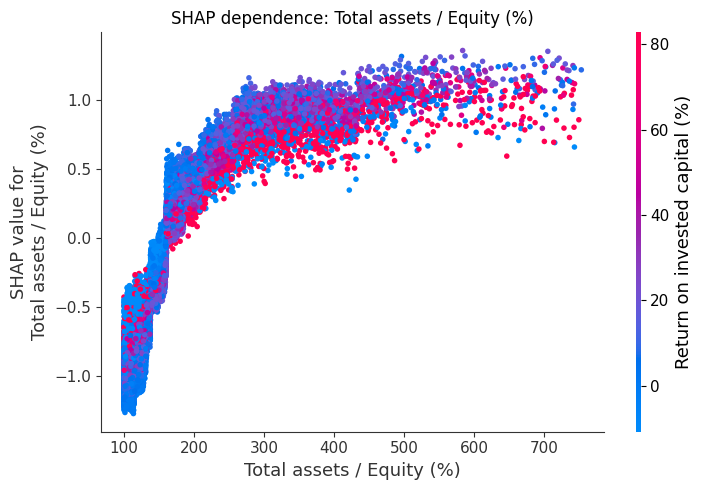

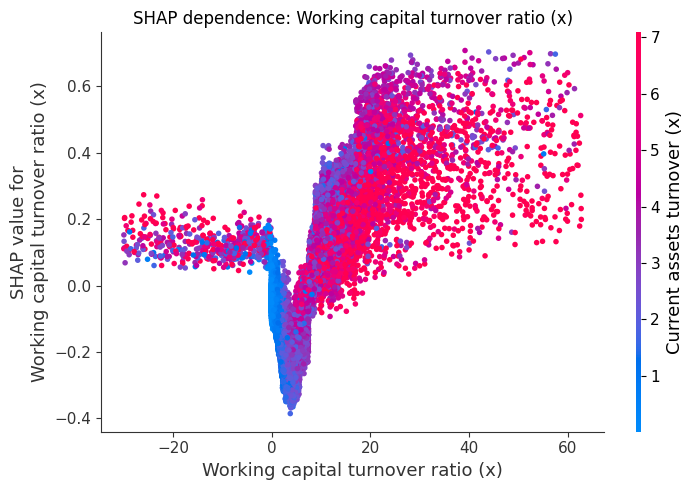

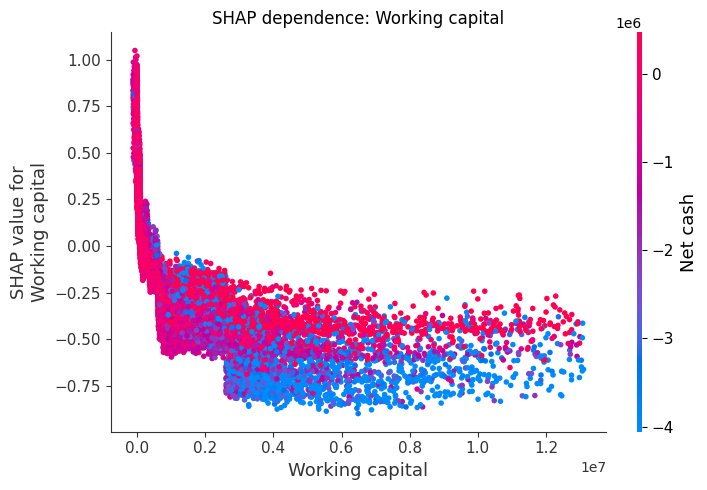

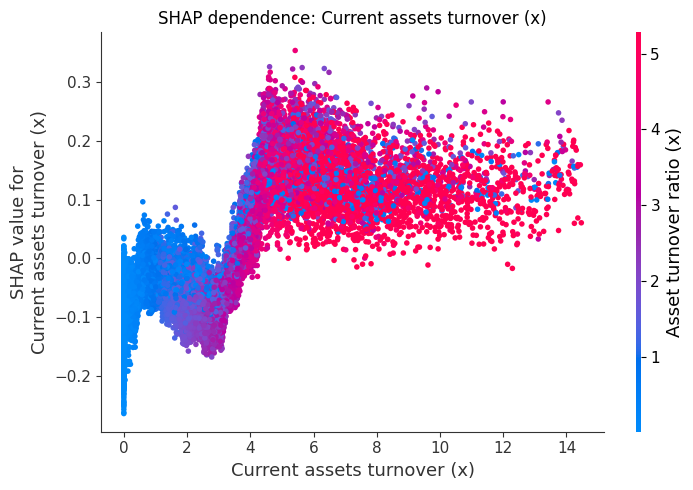

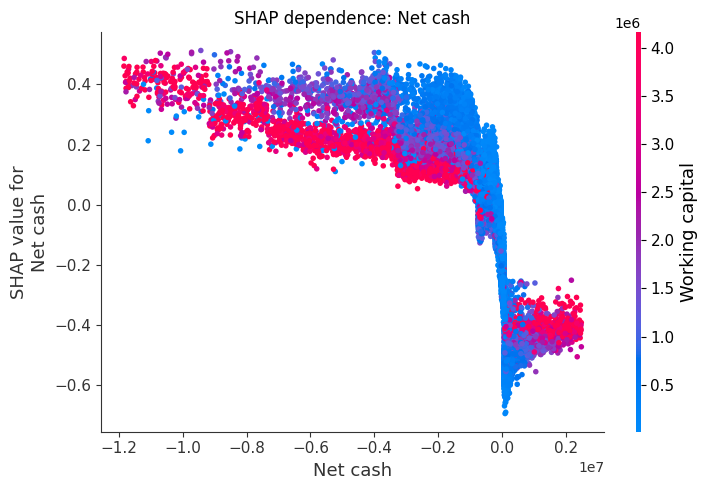

...

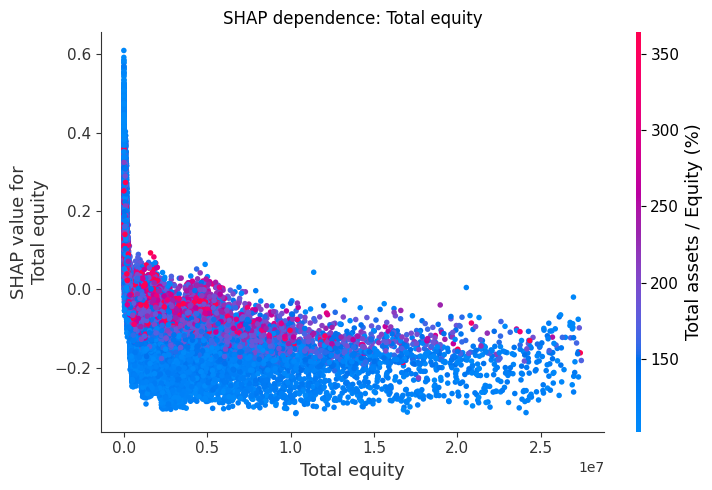

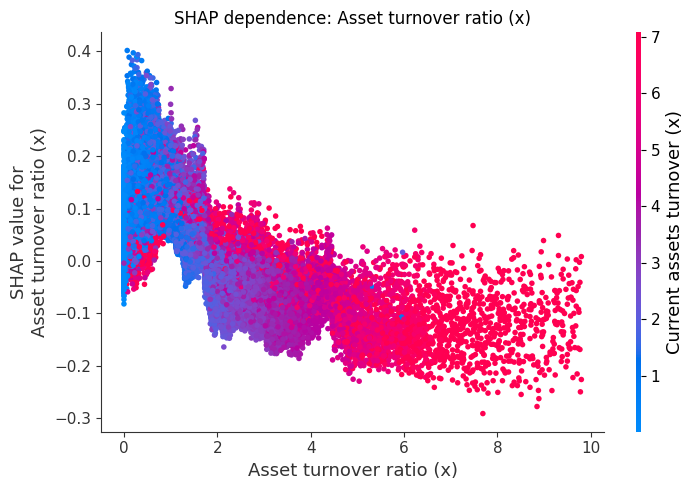

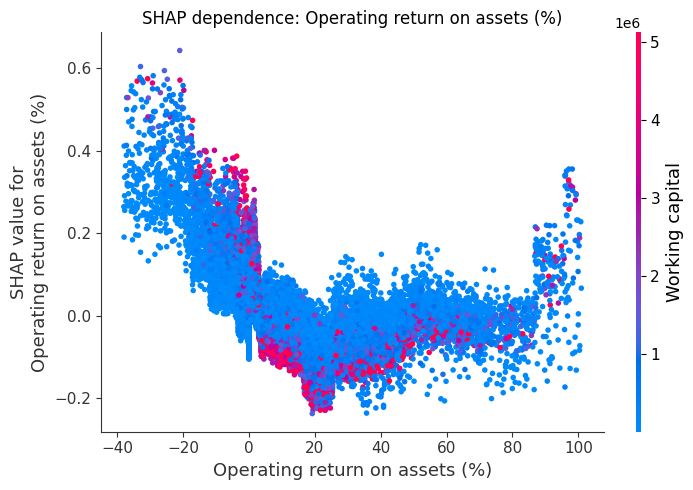

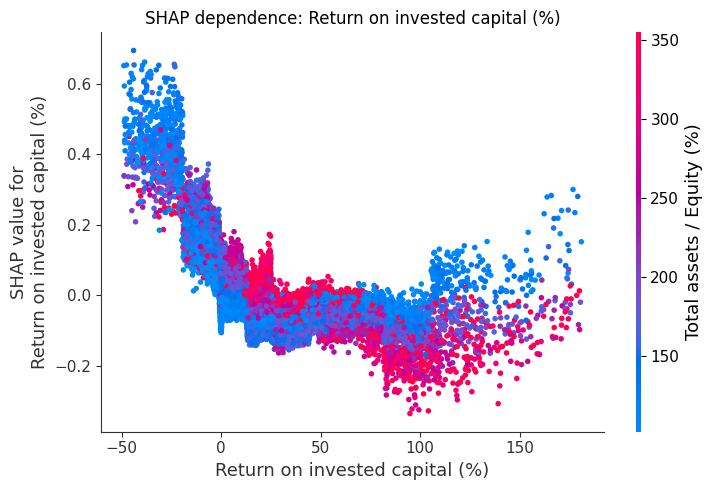

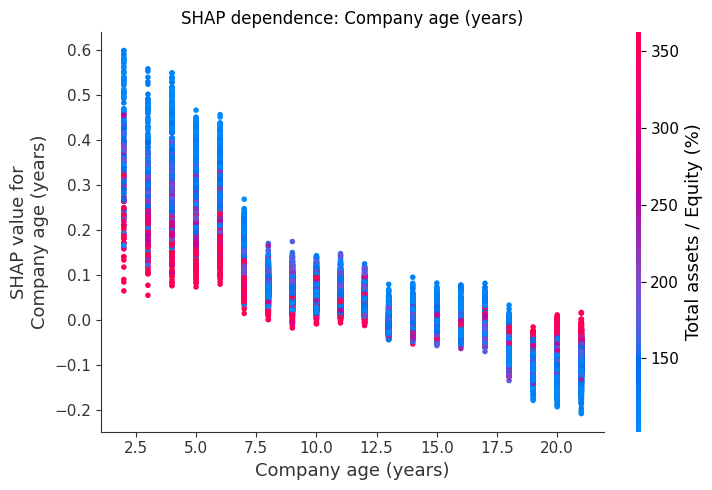

In [112]:
for i in X.columns:
    # Percentiles calculation 
    lower = np.percentile(X[i], 1)
    upper = np.percentile(X[i], 99)

    # Outliers filtering 
    mask = (X[i] >= lower) & (X[i] <= upper)
    X_filtered = X[mask]
    shap_filtered = shap_values[mask.values]

    # Plot
    shap.dependence_plot(i, shap_filtered, X_filtered, show=False)
    plt.title(f'SHAP dependence: {i}')
    plt.tight_layout()
    plt.show()


### 5. Local interpretability 

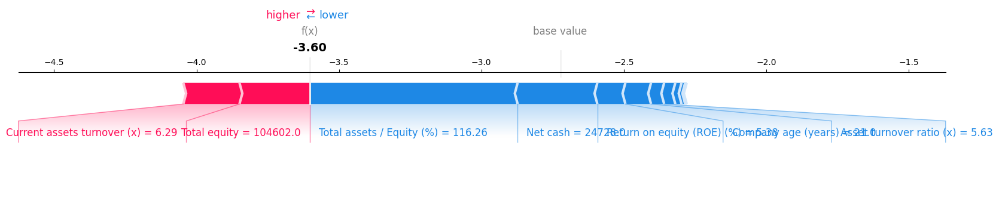

In [113]:
shap_plot = shap.force_plot(
    explainer.expected_value, 
    shap_values[0], 
    X.iloc[0], 
    matplotlib=True
)

### 6. Decision plot 

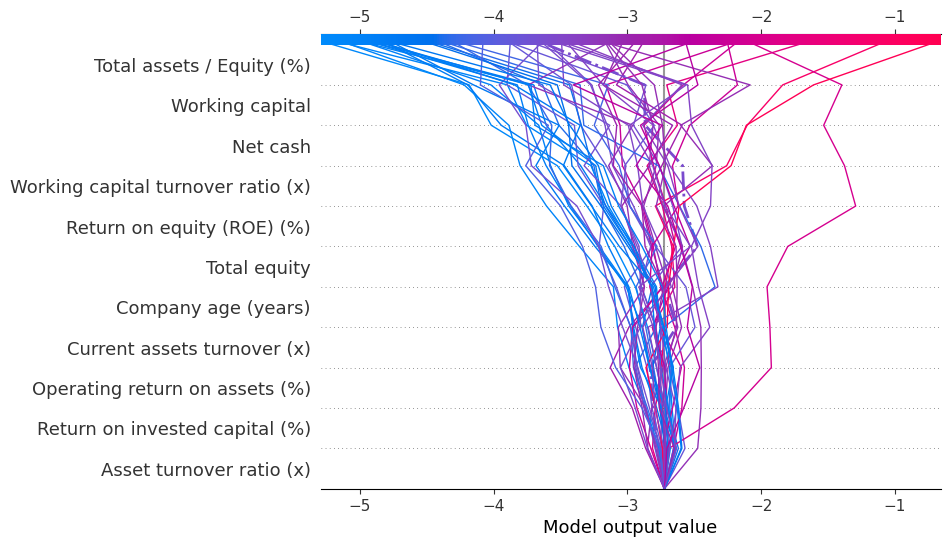

In [114]:
shap.decision_plot(
    explainer.expected_value,          
    shap_values[:50],              
    X.iloc[:50],                        
    feature_names=X.columns.tolist(),  
    highlight=0                        
)

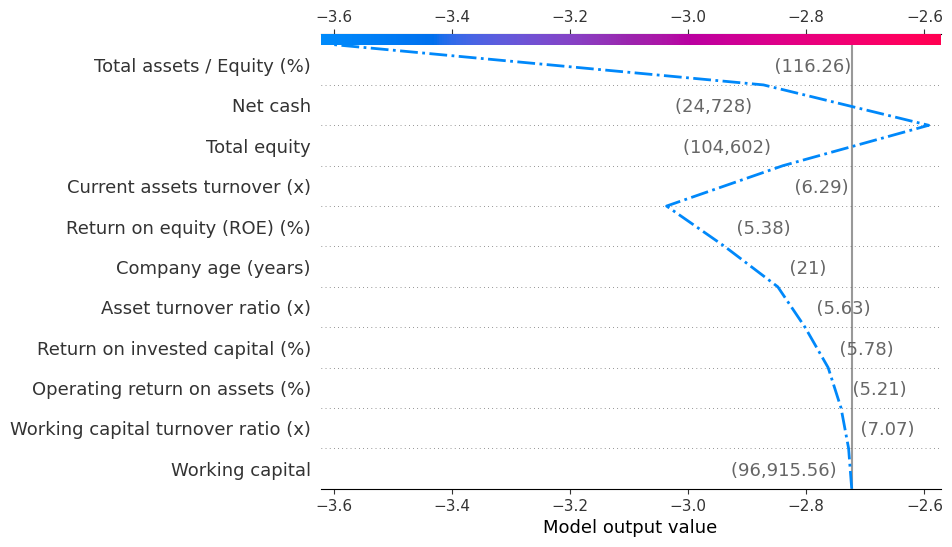

In [115]:
shap.decision_plot(
    explainer.expected_value,          
    shap_values[:1],              
    X.iloc[:1],                        
    feature_names=X.columns.tolist(),  
    highlight=0                        
)

### 7. SHAP waterfall plot 

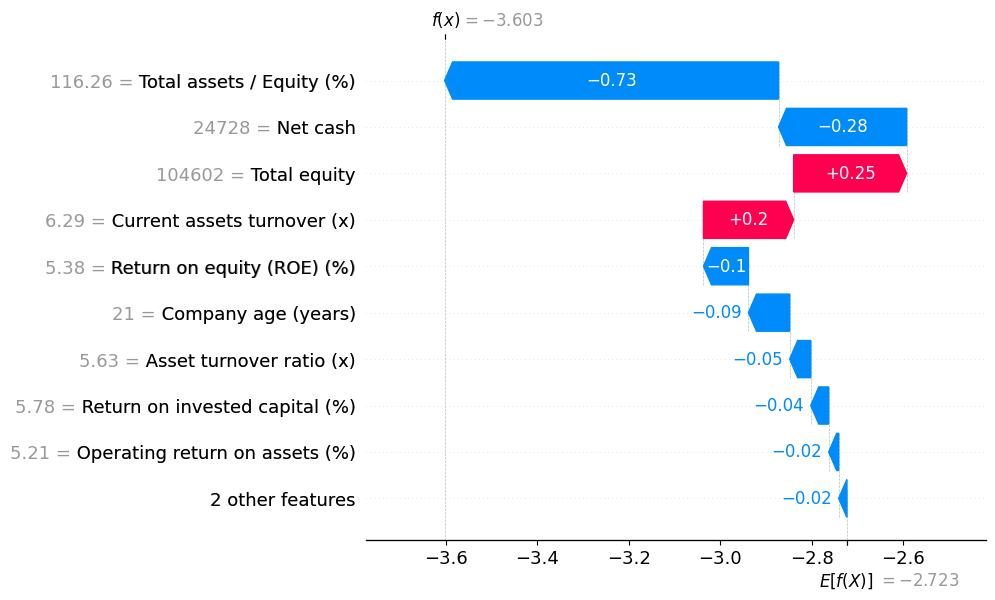

In [116]:
shap.plots.waterfall(
    shap.Explanation(
        values=shap_values[0],
        base_values=explainer.expected_value,
        data=X.iloc[0],
        feature_names=X.columns.tolist()
    )
)

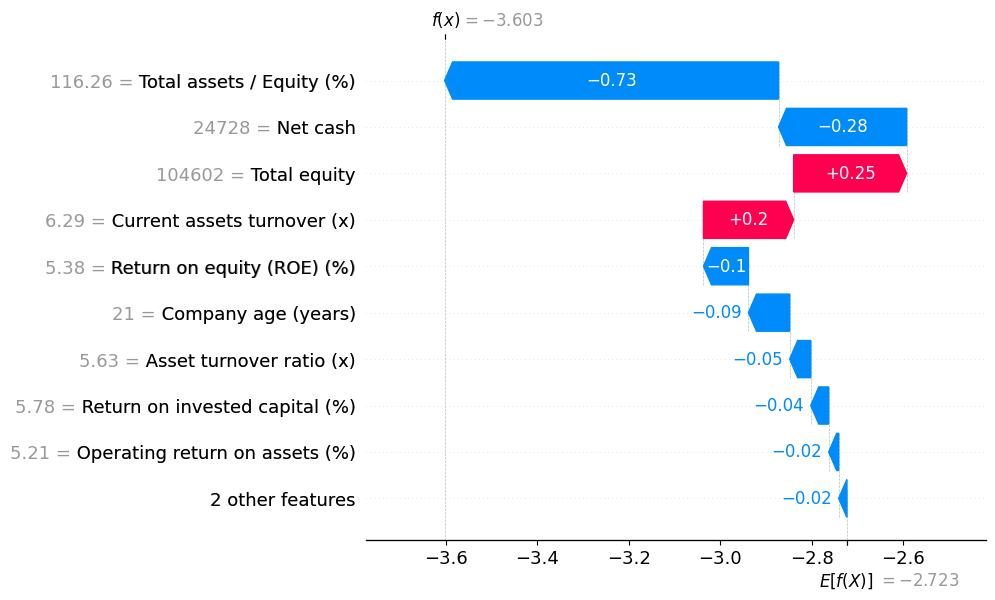

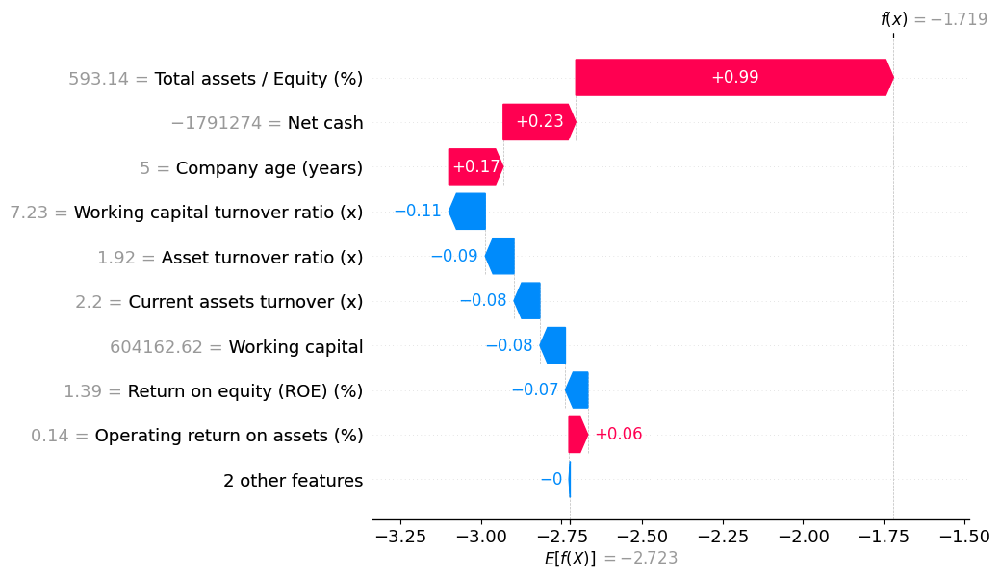

In [117]:
# Find one correctly and one incorrectly classified observation
# Assumes binary classification with 0/1 labels
correct_idx = np.where((y_preds_opt == y_test).values)[0][0]
incorrect_idx = np.where((y_preds_opt != y_test).values)[0][0]

# SHAP waterfall for correctly classified observation
shap.plots.waterfall(
    shap.Explanation(
        values=shap_values[correct_idx],
        base_values=explainer.expected_value,
        data=X.iloc[correct_idx],
        feature_names=X.columns.tolist()
    )
)

# SHAP waterfall for incorrectly classified observation
shap.plots.waterfall(
    shap.Explanation(
        values=shap_values[incorrect_idx],
        base_values=explainer.expected_value,
        data=X.iloc[incorrect_idx],
        feature_names=X.columns.tolist()
    )
)

## LIME

In [118]:
X_train_array = X.values
X_test_array = X_test.values

In [119]:
explainer = LimeTabularExplainer(
    training_data=X_train_array,
    feature_names=X.columns.tolist(),
    class_names=['Good', 'Bad'], 
    mode='classification',
    discretize_continuous=True  
)

In [120]:
i = 0  

exp = explainer.explain_instance(
    data_row=X_train_array[i],
    predict_fn=xgb_model.predict_proba,  
    num_features=10
)

### 1. Local interpretation

In [121]:
exp.show_in_notebook(show_table=True)

In [122]:
for i in range(10):
    exp = explainer.explain_instance(
        X_test_array[i],
        xgb_model.predict_proba,
        num_features=10
    )
    exp.show_in_notebook(show_table=True)

### ROC curve

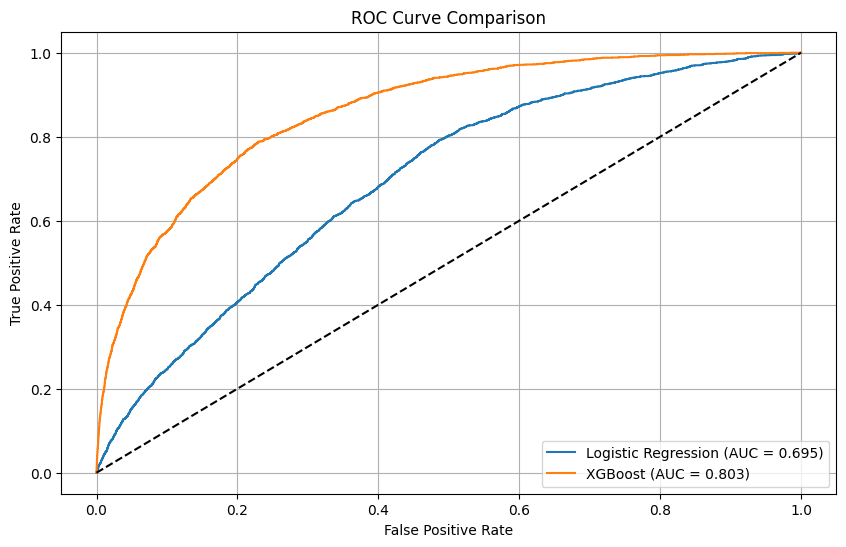

In [123]:
# Logistic regression ROC
fpr_logit, tpr_logit, _ = roc_curve(y, result.predict(X_const))
roc_auc_logit = auc(fpr_logit, tpr_logit)

# XGBoost ROC
fpr_xgb, tpr_xgb, _ = roc_curve(y, xgb_model.predict_proba(X)[:, 1])
roc_auc_xgb = 0.803

# Plotting
plt.figure(figsize=(10, 6))
plt.plot(fpr_logit, tpr_logit, label=f'Logistic Regression (AUC = {roc_auc_logit:.3f})')
plt.plot(fpr_xgb, tpr_xgb, label=f'XGBoost (AUC = {roc_auc_xgb:.3f})')
plt.plot([0, 1], [0, 1], 'k--')  # Diagonal line
plt.xlabel('False Positive Rate')
plt.ylabel('True Positive Rate')
plt.title('ROC Curve Comparison')
plt.legend(loc='lower right')
plt.grid()
plt.show()

### PDPs and ICE plots

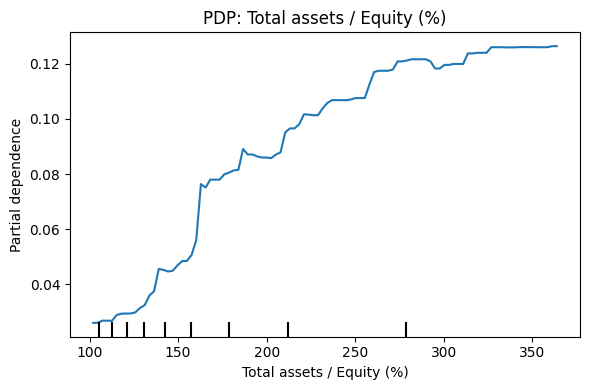

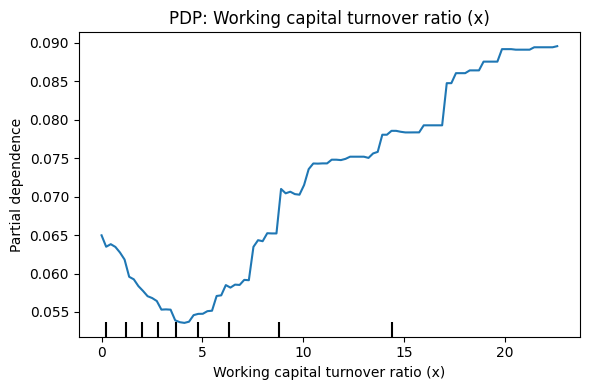

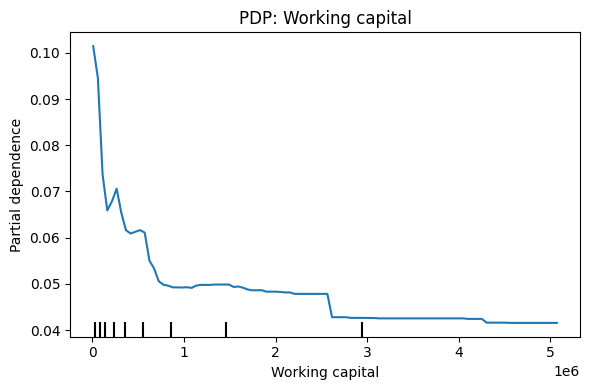

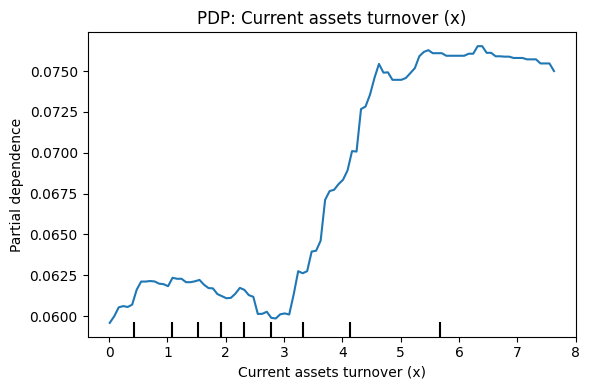

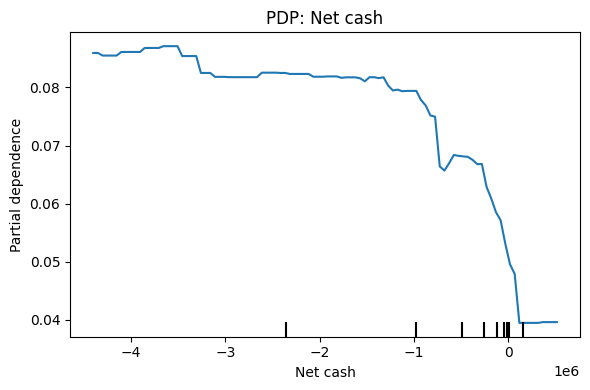

...

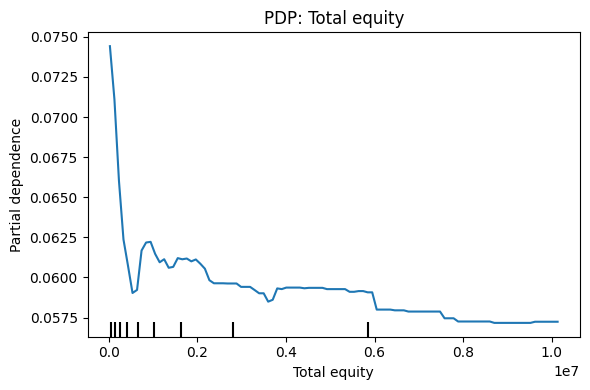

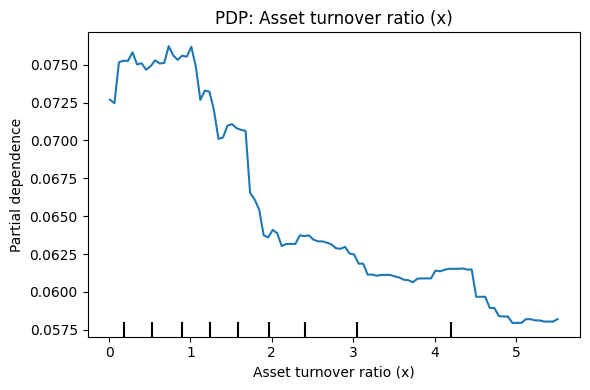

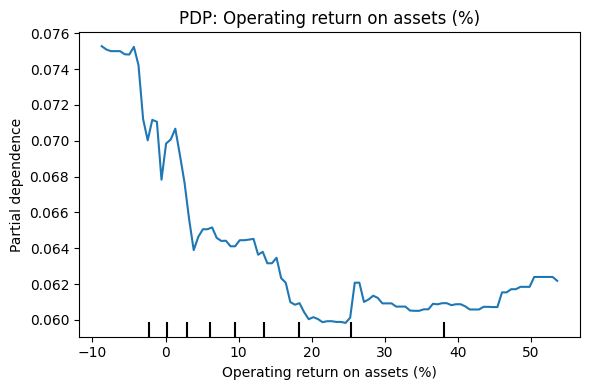

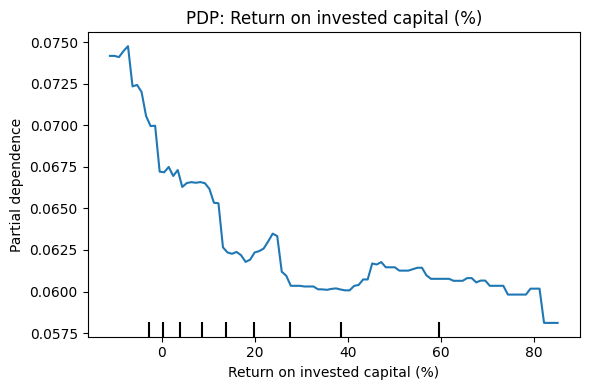

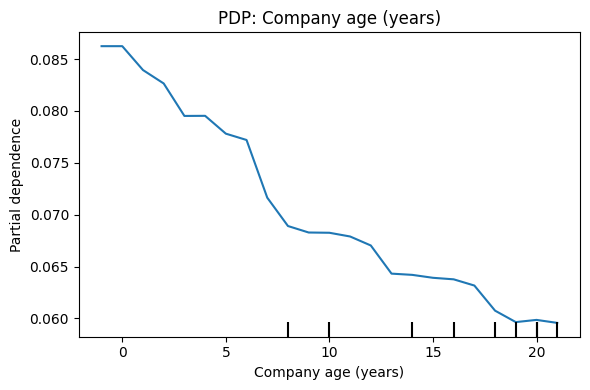

In [124]:
for feature in X.columns:
    fig, ax = plt.subplots(figsize=(6, 4))
    PartialDependenceDisplay.from_estimator(
        estimator=xgb_model,
        X=X,
        features=[feature],  # Single feature in a list
        kind='average',      # PDP only
        grid_resolution=100,
        ax=ax
    )
    ax.set_title(f'PDP: {feature}')
    plt.tight_layout()
    plt.show()

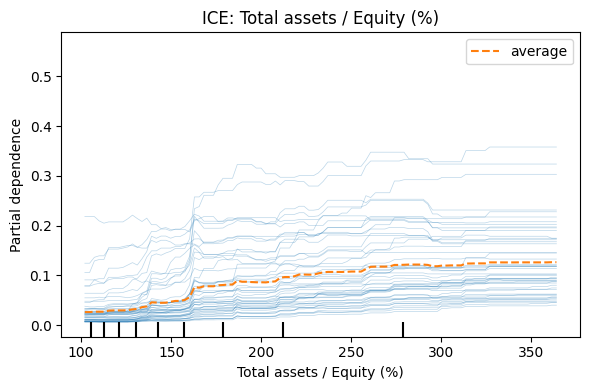

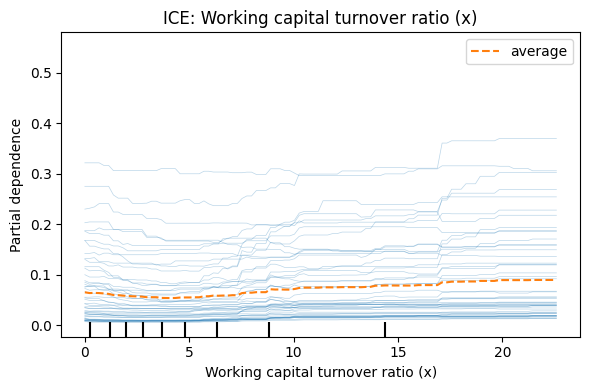

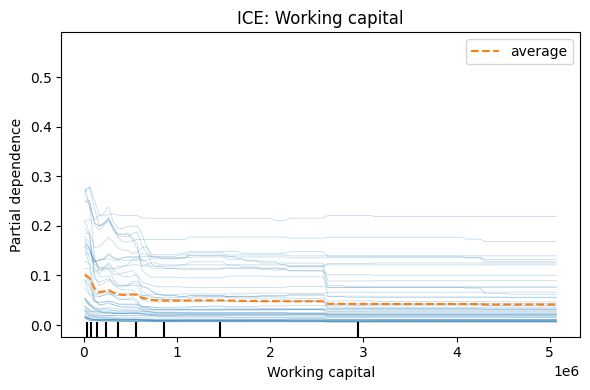

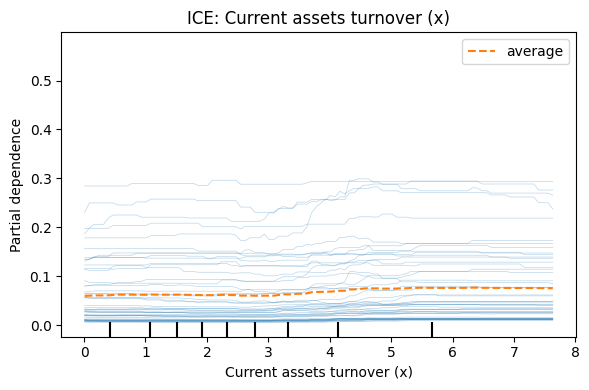

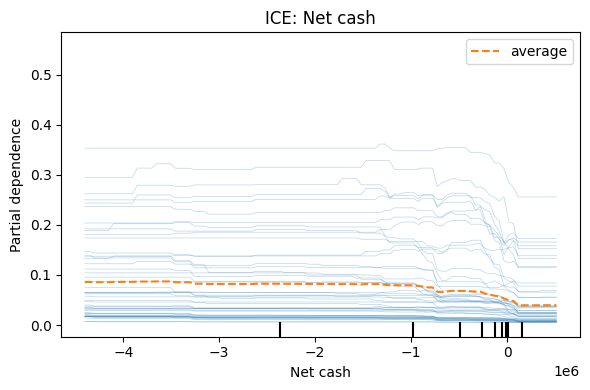

...

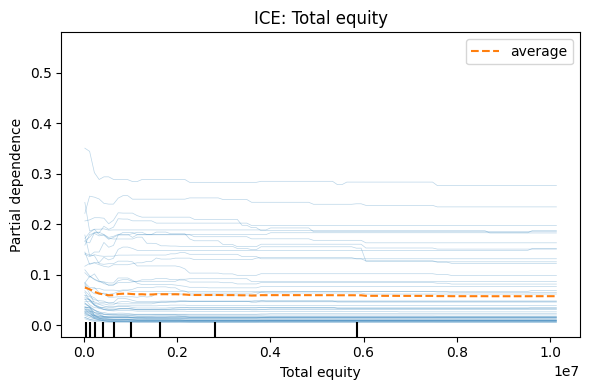

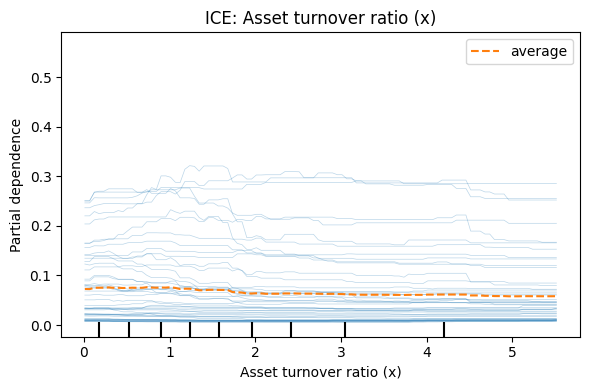

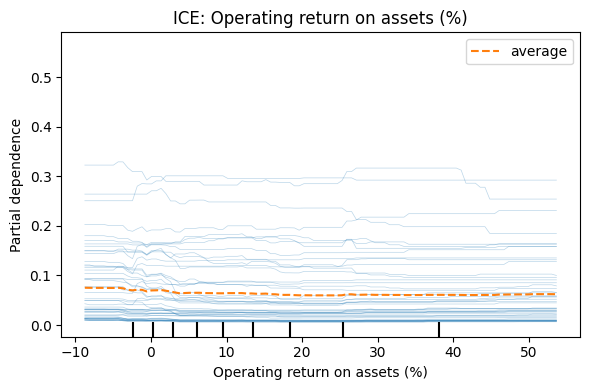

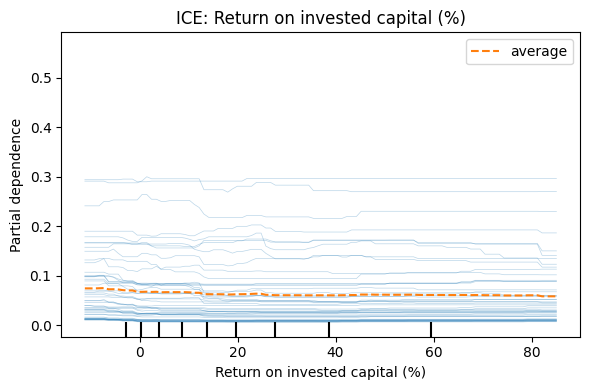

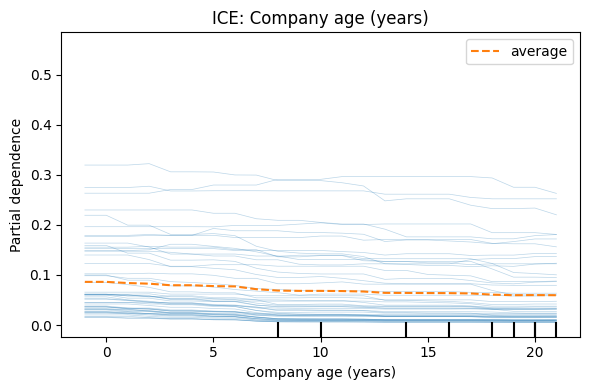

In [125]:
for feature in X.columns:
    fig, ax = plt.subplots(figsize=(6, 4))
    PartialDependenceDisplay.from_estimator(
        estimator=xgb_model,
        X=X,
        features=[feature],
        kind='both',          # 'both' = ICE + PDP
        grid_resolution=100,
        subsample=50,         # Show fewer ICE lines for clarity
        random_state=42,
        ax=ax
    )
    ax.set_title(f'ICE: {feature}')
    plt.tight_layout()
    plt.show()